In [1]:
from utils_analysis import *

In [2]:
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

In [3]:
sns.set_style('whitegrid', {'font.family': 'Times New Roman'})
font_title = {'color':  'black',
              'weight': 'bold',
              'size': 26}
font_axis = {'color':  'black',
              'weight': 'bold',
              'size': 25}
font_tick_size = 20
legend_properties = {'weight':'normal','size':14}
sns.set_context("paper", font_scale=2, rc={"lines.linewidth": 2.1})
# sns.set(font='Times New Roman')
# sns.set_style('whitegrid')

In [4]:
def set_legend(fig, ax):
    # assign legened to figureusing bbox coordinates
    x_shift = 0.95 # 0.98
    y_shift = 0.45
    bbox = (fig.subplotpars.left+x_shift, fig.subplotpars.top-y_shift, fig.subplotpars.right-fig.subplotpars.left,.1)
    ax.legend(bbox_to_anchor=bbox, loc='lower left', ncol=1, borderaxespad=0., bbox_transform=fig.transFigure,
                       frameon=False,title=None,prop=legend_properties)
    # set font weight and font size of the legend title
    ax.get_legend().get_title().set_fontweight('bold')
    ax.get_legend().get_title().set_fontsize(22)

In [5]:
def set_ticks(axes, titles, fts=None, weight=None):
    fts = font_tick_size if fts is None else fts
    axes = axes.flatten()
#     titles = np.tile(titles, len(axes) // len(titles))
    for i, ax in enumerate(axes):
        if i < len(titles):
            ax.set_title(titles[i], fontdict=font_title, y=1.05)
        else:
            ax.set_title('')
        # call the tick labels of the x and y axes
        for tick in ax.xaxis.get_ticklabels():
            tick.set_fontsize(fts)  # set tick font size
            tick.set_weight(weight)
        for tick in ax.yaxis.get_ticklabels():
            tick.set_fontsize(fts)
            tick.set_weight(weight)
    return ax

In [6]:
def decorate(sns_plot, titles, skip_legend=False):
    ax = set_ticks(sns_plot.axes, titles)
    if not skip_legend:
        set_legend(sns_plot.fig, ax)
    sns_plot.set_xlabels(fontdict=font_axis)
    sns_plot.set_ylabels(fontdict=font_axis)

In [7]:
fig_folder = r'C:\Users\Minh\Google Drive\Writing\RadPath\Analysis\raw_images\line_width2.5'.replace('\\', '/')
def save_fig(fig_name, bbox_inches=None):
    return
    plt.savefig(f'{fig_folder}/{fig_name}.png', bbox_inches=bbox_inches)

# Non-split

## Diameter = 7

In [8]:
d = 5
f = read_pdf(d)
norm_df(f)

In [9]:
reduced_ticks = ['EPI', 'ENUC', 'STR', 'LUM', 'T2W', 'ADC']
# corr = f[tissue_types + img_types].corr('pearson').round(3)
# mask = np.zeros_like(corr)
# # mask[np.triu_indices_from(mask)] = True

# sns.set_context(font_scale=1.5)
# hm = sns.heatmap(corr, vmin=-1, vmax=1, annot=True, # mask=mask, 
#                  annot_kws={"fontsize":16}, cmap='coolwarm',
#                  xticklabels=reduced_ticks, yticklabels=reduced_ticks)
# save_fig('heat_map_non_split')
# sns.set_context(font_scale=1)

In [10]:
corr_tables_non_split = gather_corr_tables_non_split()
corr_tables_non_split

,Tissue,Diameter,T2W,ADC,T2W_P,ADC_P
0,Epithelium,7mm,-0.126491,-0.436915,5e-05,0
1,Epithelial Nuclei,7mm,0.062402,-0.243583,0.04686,0
2,Stroma,7mm,-0.059347,0.245327,0.05875,0
3,Lumen,7mm,0.521955,0.531385,0,0
4,Epithelium,5mm,-0.113817,-0.429770,0.00028,0
5,Epithelial Nuclei,5mm,0.077034,-0.241821,0.01409,0
6,Stroma,5mm,-0.073688,0.242114,0.01888,0
7,Lumen,5mm,0.513425,0.521515,0,0
8,Epithelium,3mm,-0.103663,-0.423047,0.00094,0
9,Epithelial Nuclei,3mm,0.088744,-0.244781,0.00466,0


In [11]:
corr_tables_non_split = corr_tables_non_split.melt(id_vars=('Tissue', 'Diameter'), value_vars=img_types, 
                                                   value_name='Correlation Coeffecient', var_name='Modality')

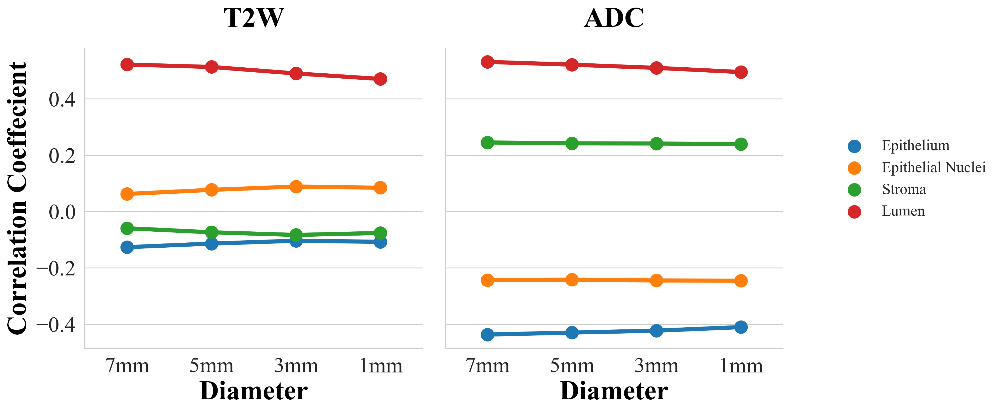

In [12]:
catplot = sns.catplot(x='Diameter', y='Correlation Coeffecient', hue='Tissue', 
                      legend=False, data=corr_tables_non_split, kind="point", col='Modality')
catplot.set_xlabels('Diameter', fontdict=font_axis)
catplot.set_ylabels('Correlation Coefficient', fontdict=font_axis)
decorate(catplot, corr_tables_non_split.Modality.unique())
save_fig('corr_sep_modality_across_diameter_non_split')

# Bengin & Cancer

## Correlation graphs

In [13]:
d = 3
f = read_pdf(d)
corr_tables = get_corr_table(f, merge_grades=True)
corr_tables['p-value'] = np.round(corr_tables['p-value'], 3)
corr_tables['corr'] = np.round(corr_tables['corr'], 4)
corr_tables[['corr', 'p-value']]

,corr,p-value
0,0.0269,0.474
1,0.2248,0.000
2,-0.2293,0.000
3,0.5072,0.000
4,-0.1982,0.000
5,-0.0877,0.126
6,0.1284,0.025
7,0.2957,0.000
8,-0.2988,0.000
9,-0.1120,0.003


## Scatter plots

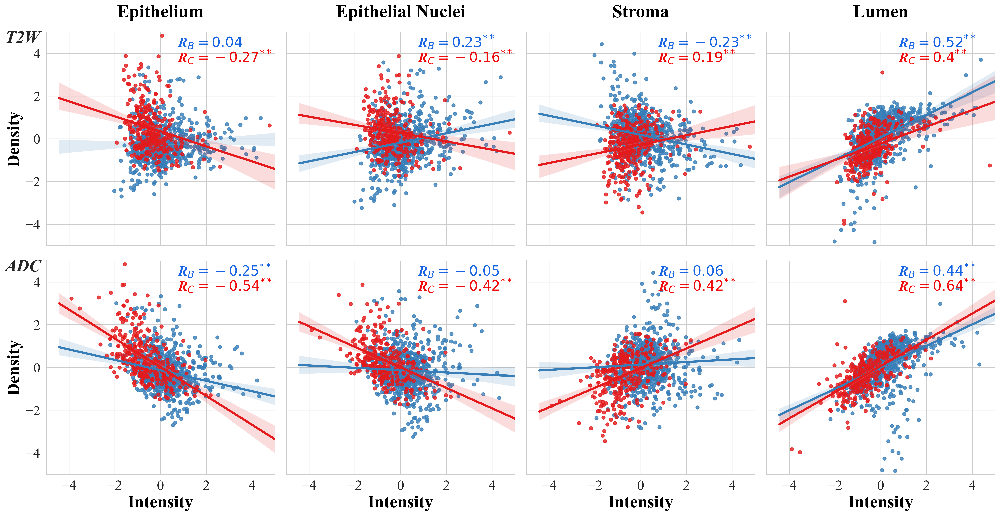

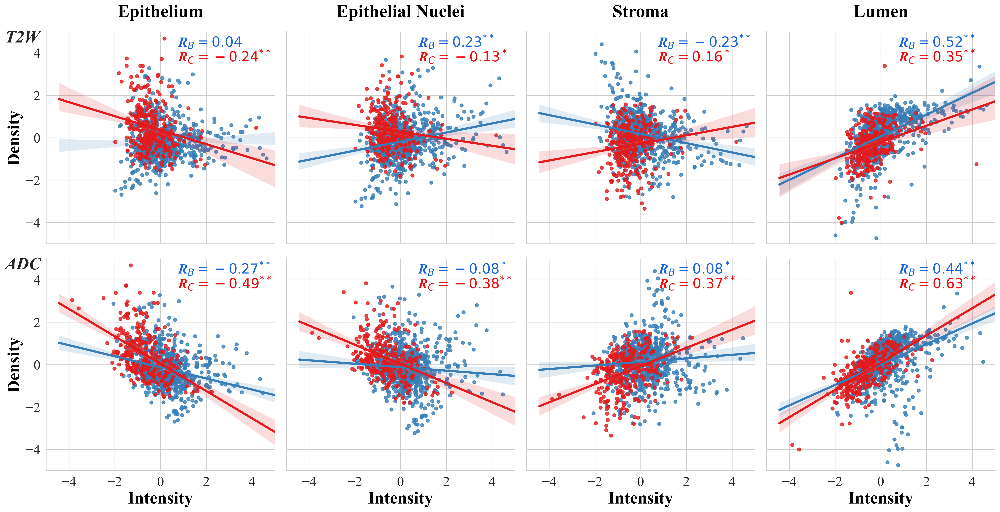

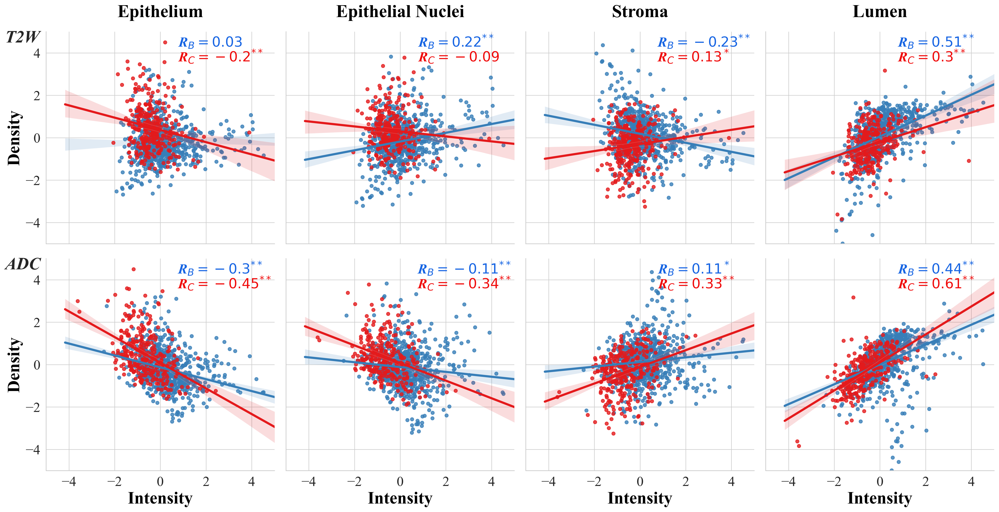

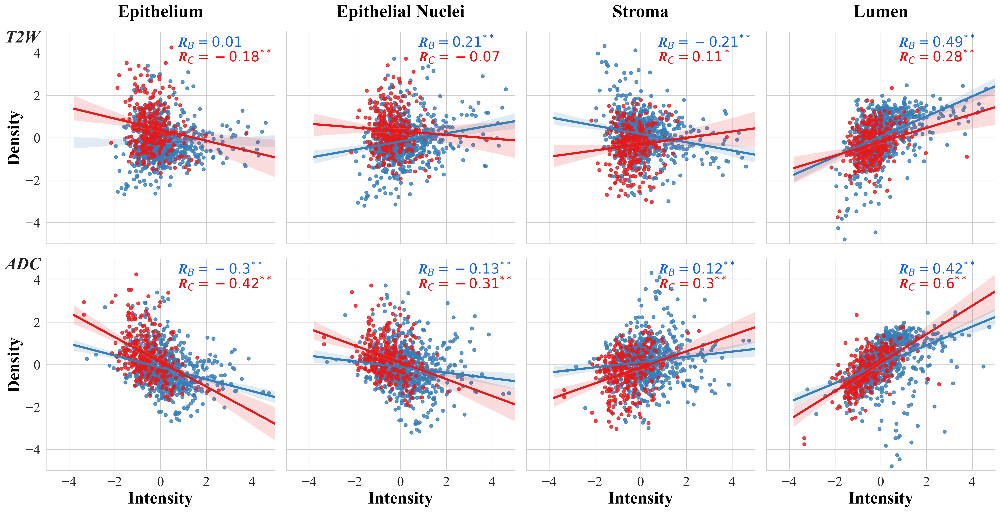

In [14]:
for d in [7, 5, 3, 1]: 
    f = read_pdf(d)
    corr_tables = get_corr_table(f, merge_grades=True)
    corr_tables['p-value'] = np.round(corr_tables['p-value'], 3)
    corr_tables['corr'] = np.round(corr_tables['corr'], 4)

    f['Condition'].replace(-1, 0, inplace=True)  # Replace G
    f_melt = melt_df(f, d, for_scatter=True)
    f_melt['Condition'].replace({0: 'Benign', 1: 'Cancer'}, inplace=True)

    # Construct annotations
    annotations = {'T2W': {}, 'ADC': {}}
    for i in range(len(corr_tables)):
        c, tissue, mod = corr_tables.loc[i][['Grade', 'index', 'MR Modality']]
        s = 'R$_B' if c == 'Benign' else 'R$_C'
        s += f' = {np.round(corr_tables["corr"][i], 2)}'
        if corr_tables['p-value'][i] < .005:
            s += '^{**}'  
        elif corr_tables['p-value'][i] < .05:
            s += '^*'
        else:
            s += ''
        loc = (3, 4.5) if c == 'Benign' else (3, 4)
        if tissue not in annotations[mod].keys():
            annotations[mod][tissue] = s + "$"
        else:
            annotations[mod][tissue] += '\n' + s + "$"

    # Combined plots
    f_melt2 = pd.melt(
        f_melt, id_vars=f_melt.columns.difference(img_types), value_vars=img_types,
        var_name='Modality', value_name='Intensity',
    )

    palette = sns.color_palette('Set1' , 2)
    palette.reverse()
    txt_x, txt_y = (1.2, 1.2), (4.3, 3.6)
    # with sns.color_palette(palette):
    lmplot = sns.lmplot(x='Intensity', y='Density', hue='Condition', data=f_melt2, col='Tissue Component', legend=False, row='Modality',
                        aspect=1, hue_order=['Benign', 'Cancer'], palette=palette, truncate=False,
                       ).set(xlim=(-5, 5), ylim=(-5, 5))
    decorate(lmplot, f_melt['Tissue Component'].unique(), skip_legend=True)
    lmplot.set_xlabels('Intensity').fig.subplots_adjust(wspace=.05, hspace=.07)
    axes = lmplot.axes.flatten()
    axes[0].text(-6.8, 4.5, 'T2W', fontdict={'fontstyle': 'oblique', 'weight': 'bold', 'size': 25})
    axes[4].text(-6.8, 4.5, 'ADC', fontdict={'fontstyle': 'oblique', 'weight': 'bold', 'size': 25})

    for ax, k in zip(axes[:len(tissue_types)], annotations['T2W']):
        s = annotations['T2W'][k].split('\n')
        offset = max(len(s[0]), len(s[1])) * .025
        ax.text(txt_x[0] - offset, txt_y[0], s[0], fontdict={'fontstyle': 'oblique', 'weight': 'bold', 'size': 20, 'color': '#1765e3'})
        ax.text(txt_x[1] - offset, txt_y[1], s[1], fontdict={'fontstyle': 'oblique', 'weight': 'bold', 'size': 20, 'color': '#f00c0c'})

    for ax, k in zip(axes[len(tissue_types):], annotations['ADC']):
        s = annotations['ADC'][k].split('\n')
        offset = max(len(s[0]), len(s[1])) * .025
        ax.text(txt_x[0] - offset, txt_y[0], s[0], fontdict={'fontstyle': 'oblique', 'weight': 'bold', 'size': 20, 'color': '#1765e3'})
        ax.text(txt_x[1] - offset, txt_y[1], s[1], fontdict={'fontstyle': 'oblique', 'weight': 'bold', 'size': 20, 'color': '#f00c0c'})
    save_fig(f'scatter_2class_{d}mm')

# 4 Groups

## Correlation plots

In [15]:
d = 1
f = read_pdf(d)
corr_tables = get_corr_table(f)
corr_tables['p-value'] = np.round(corr_tables['p-value'], 4)
corr_tables['corr'] = np.round(corr_tables['corr'], 5)

corr_tables['R-squared'] = corr_tables['corr'] ** 2
corr_tables.rename(columns={'index': 'Tissue'}, inplace=True)
corr_tables[['corr', 'p-value']]

,corr,p-value
0,0.26250,0.0087
1,0.48901,0.0000
2,-0.48059,0.0000
3,0.53817,0.0000
4,0.02535,0.5317
5,0.15600,0.0001
6,-0.16822,0.0000
7,0.42854,0.0000
8,-0.24772,0.0012
9,-0.15106,0.0513


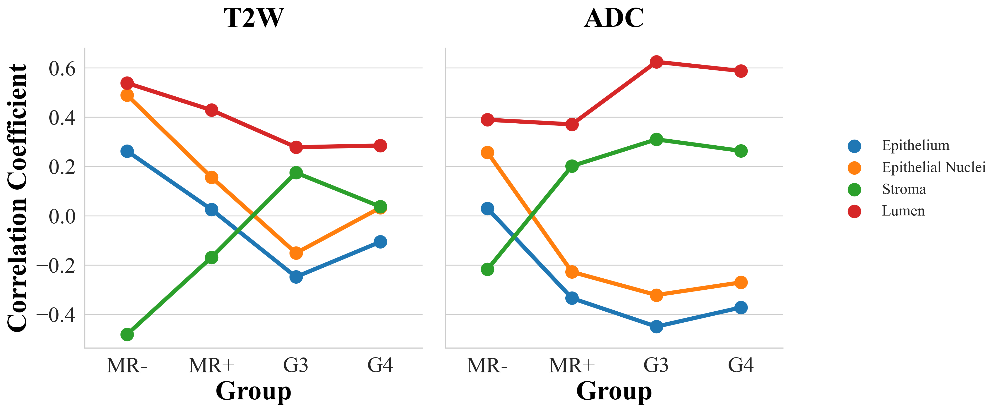

In [16]:
catplot = sns.catplot(x='Grade', y='corr', hue='Tissue', col='MR Modality', data=corr_tables, kind="point", legend=False)
decorate(catplot, img_types)
catplot.set_xlabels('Group', fontdict=font_axis)
catplot.set_ylabels('Correlation Coefficient', fontdict=font_axis)
save_fig('corr_sep_modality_4class')

In [17]:
sns.set_style('whitegrid', {'font.family': 'Times New Roman'})
palette = sns.color_palette('viridis' , 2)
sns.set_palette(palette)
sns.set_context("paper", font_scale=1.5, rc={"lines.linewidth": 2.})

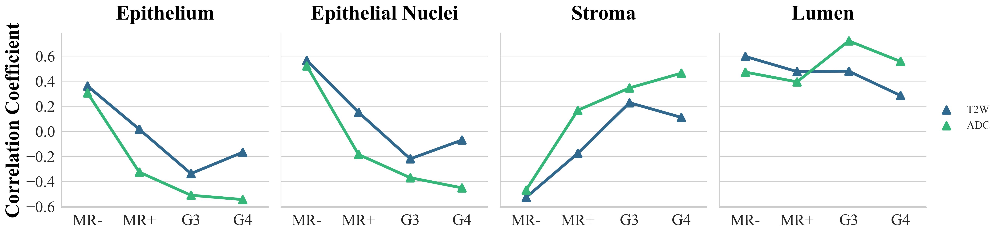

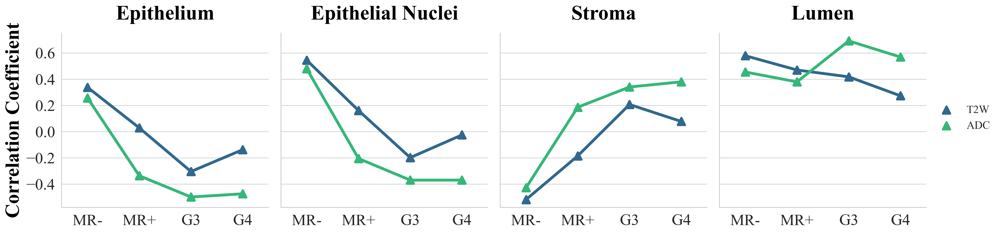

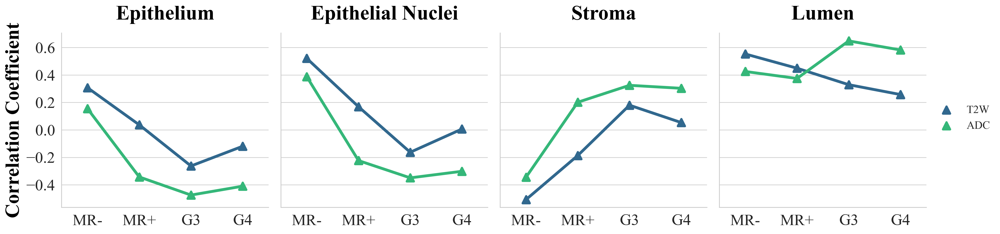

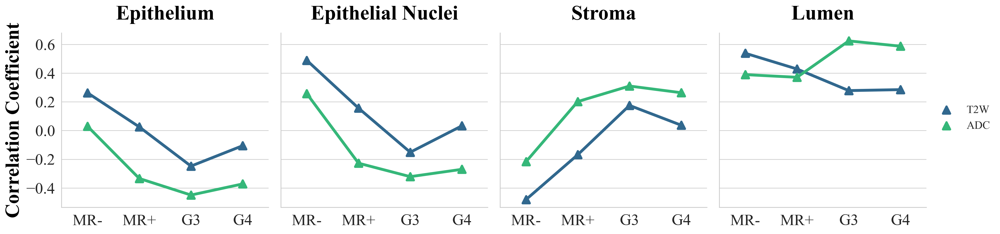

In [18]:
corr_tables_multiple_d = []
for d in [7, 5, 3, 1]:
    f = read_pdf(d)
    corr_tables = get_corr_table(f)
    corr_tables['p-value'] = np.round(corr_tables['p-value'], 3)
    corr_tables['corr'] = np.round(corr_tables['corr'], 4)

    corr_tables['R-squared'] = corr_tables['corr'] ** 2
    corr_tables.rename(columns={'index': 'Tissue'}, inplace=True)
    corr_tables.d = d
    corr_tables_multiple_d.append(corr_tables)
    catplot = sns.catplot(x='Grade', y='corr', hue='MR Modality', col='Tissue', data=corr_tables, kind="point", legend=False,
                     height=4, markers='^')  # col_wrap=2
    decorate(catplot, corr_tables.Tissue.unique())
    catplot.set_xlabels('', fontdict=font_axis)
    catplot.set_ylabels('Correlation Coefficient', fontdict=font_axis)

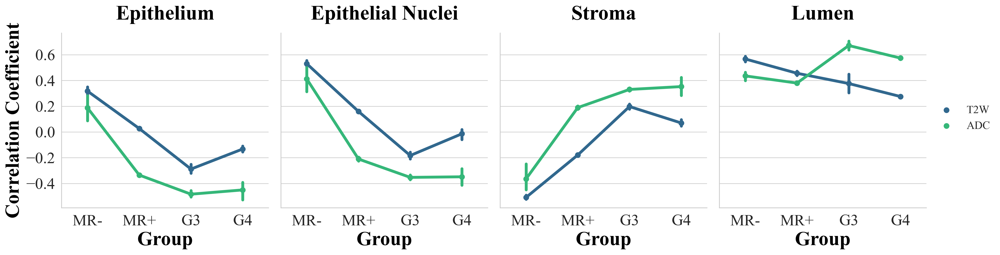

In [19]:
corr_tables = pd.concat(corr_tables_multiple_d)
catplot = sns.catplot(x='Grade', y='corr', hue='MR Modality', col='Tissue', data=corr_tables, kind="point", legend=False,
                     height=4, markers='.', ci=95)  # col_wrap=2
decorate(catplot, corr_tables.Tissue.unique())
catplot.set_xlabels('Group', fontdict=font_axis)
catplot.set_ylabels('Correlation Coefficient', fontdict=font_axis)
save_fig('corr_sep_tissue_4class')
corr_tables_multiple_d = None

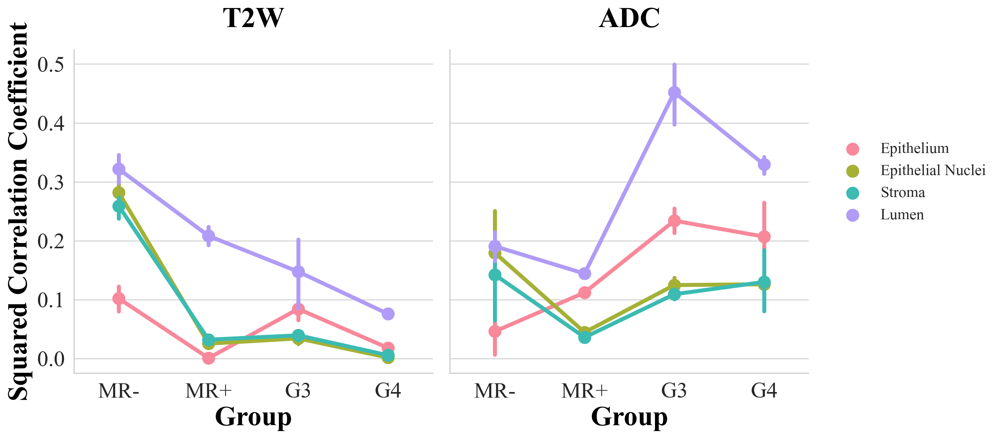

In [20]:
catplot = sns.catplot(x='Grade', y='R-squared', hue='Tissue', col='MR Modality', data=corr_tables, kind="point", legend=False)
decorate(catplot, img_types)
catplot.set_xlabels('Group', fontdict=font_axis)
catplot.set_ylabels('Squared Correlation Coefficient', fontdict=font_axis)
save_fig('Rsquared_sep_modality_4class')

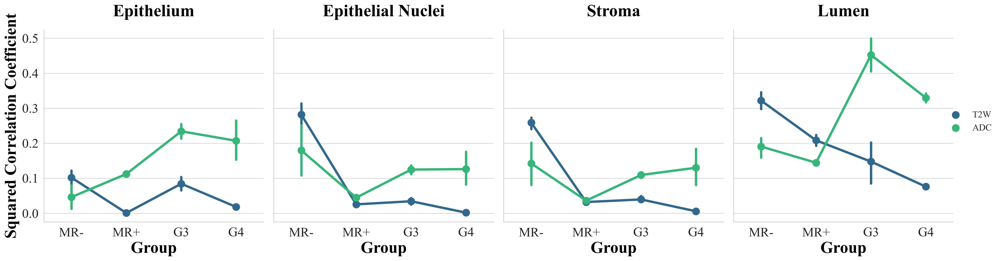

In [21]:
catplot = sns.catplot(x='Grade', y='R-squared', hue='MR Modality', col='Tissue', data=corr_tables, 
                      kind="point", legend=False)  # 
decorate(catplot, corr_tables.Tissue.unique())
catplot.set_xlabels('Group', fontdict=font_axis)
catplot.set_ylabels('Squared Correlation Coefficient', fontdict=font_axis)
save_fig('Rsquared_sep_tissue_4class')

# Across diameters

## Correlation

In [22]:
corr_tables = gather_corr_tables()

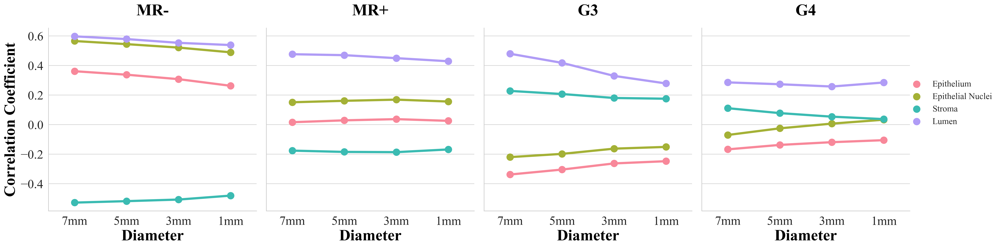

In [23]:
catplot = sns.catplot(x='diameter', y='corr', hue='Tissue', col='Group', legend=False,
                      data=corr_tables[corr_tables['MR Modality'] == 'T2W'], kind="point")  # , col_wrap=2
decorate(catplot, corr_tables.Group.unique())
catplot.set_xlabels('Diameter', fontdict=font_axis)
catplot.set_ylabels('Correlation Coefficient', fontdict=font_axis)
save_fig('corr_T2_sep_grade_across_diameter_4class')

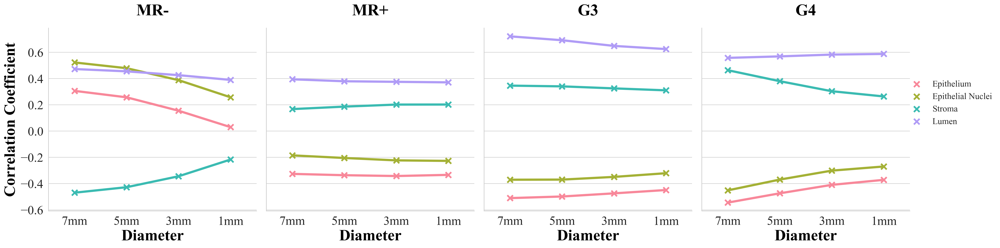

In [24]:
catplot = sns.catplot(x='diameter', y='corr', hue='Tissue', col='Group', legend=False,
                      data=corr_tables[corr_tables['MR Modality'] == 'ADC'], kind="point", markers='x')  # , col_wrap=2
decorate(catplot, corr_tables.Group.unique())
catplot.set_xlabels('Diameter', fontdict=font_axis)
catplot.set_ylabels('Correlation Coefficient', fontdict=font_axis)
save_fig('corr_ADC_sep_grade_across_diameter_4class')

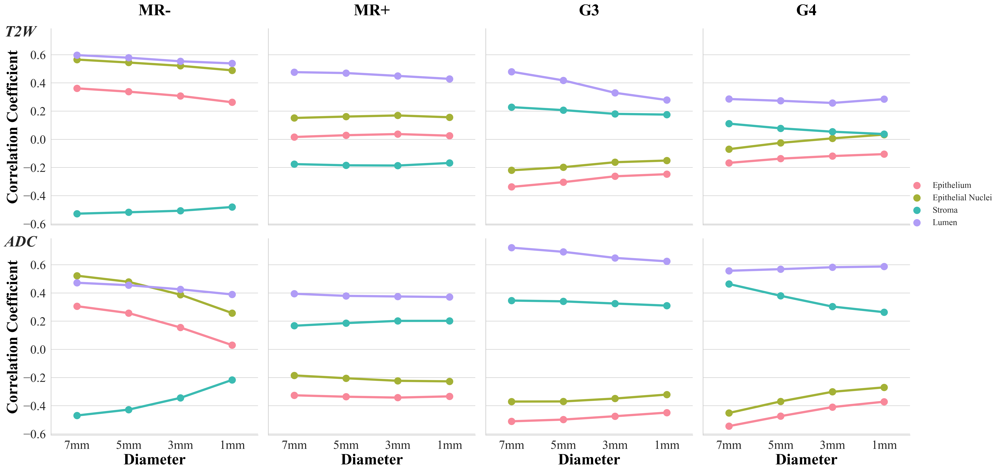

In [25]:
catplot = sns.catplot(x='diameter', y='corr', hue='Tissue', col='Group', row='MR Modality', legend=False,
                      data=corr_tables, kind="point")
decorate(catplot, corr_tables.Group.unique())
catplot.set_xlabels('Diameter', fontdict=font_axis)
catplot.set_ylabels('Correlation Coefficient', fontdict=font_axis)

catplot.fig.subplots_adjust(wspace=.05, hspace=.07)
axes = catplot.axes.flatten()
axes[0].text(-1.4, .73, 'T2W', fontdict={'fontstyle': 'oblique', 'weight': 'bold', 'size': 25})
axes[4].text(-1.4, .73, 'ADC', fontdict={'fontstyle': 'oblique', 'weight': 'bold', 'size': 25})

save_fig('corr_sep_grade_across_diameter_4class')

# Correlation with Involvement

## Bengin & Cancer

In [26]:
d = 7
f = read_pdf(d)

In [27]:
corr_tables_inv = get_corr_table(f, with_inv=True, merge_grades=True)
corr_tables_inv['p-value'] = np.round(corr_tables_inv['p-value'], 3)
corr_tables_inv['corr'] = np.round(corr_tables_inv['corr'], 4)

In [28]:
print(corr_tables_inv)

    Grade              index  MR Modality    corr  p-value
0  Cancer         Epithelium  Involvement  0.3549    0.000
1  Cancer  Epithelial Nuclei  Involvement  0.3442    0.000
2  Cancer             Stroma  Involvement -0.3342    0.000
3  Cancer              Lumen  Involvement -0.1560    0.006
4  Cancer                T2W  Involvement -0.2756    0.000
5  Cancer                ADC  Involvement -0.3364    0.000


## 4 Groups

In [29]:
corr_tables_inv = get_corr_table(f, with_inv=True)
corr_tables_inv['p-value'] = np.round(corr_tables_inv['p-value'], 3)
corr_tables_inv['corr'] = np.round(corr_tables_inv['corr'], 4)

In [30]:
print(corr_tables_inv)

   Grade              index  MR Modality    corr  p-value
0     G3         Epithelium  Involvement  0.3680    0.000
1     G3  Epithelial Nuclei  Involvement  0.3488    0.000
2     G3             Stroma  Involvement -0.3470    0.000
3     G3              Lumen  Involvement -0.1869    0.016
4     G3                T2W  Involvement -0.2888    0.000
5     G3                ADC  Involvement -0.2868    0.000
6     G4         Epithelium  Involvement  0.2700    0.001
7     G4  Epithelial Nuclei  Involvement  0.2733    0.001
8     G4             Stroma  Involvement -0.2533    0.003
9     G4              Lumen  Involvement -0.0775    0.367
10    G4                T2W  Involvement -0.2025    0.017
11    G4                ADC  Involvement -0.3230    0.000


No handles with labels found to put in legend.


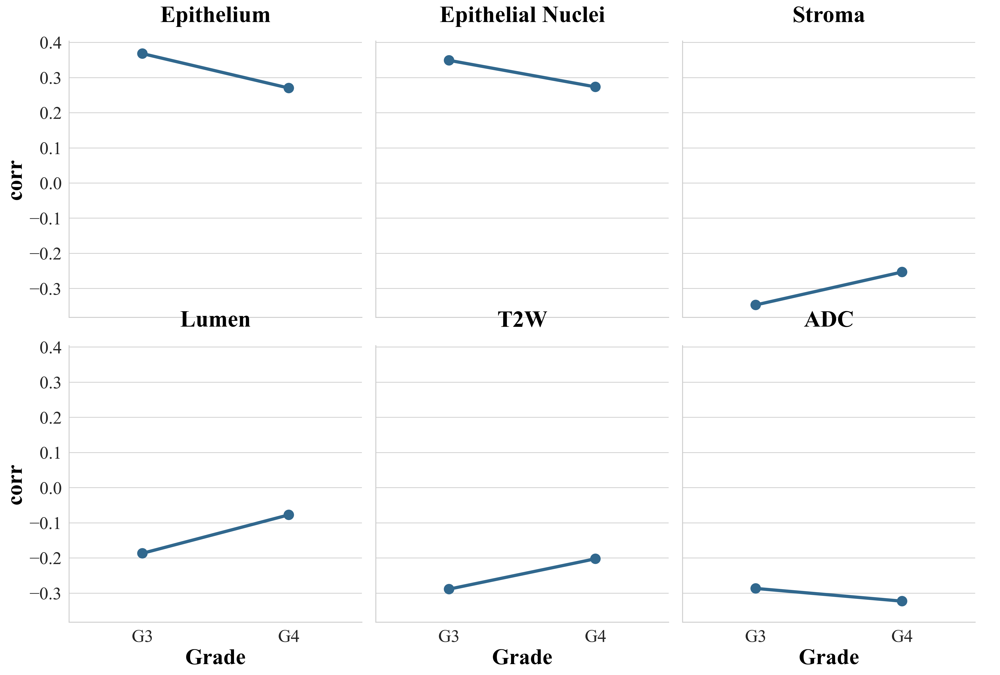

In [31]:
catplot = sns.catplot(x='Grade', y='corr', col='index', data=corr_tables_inv, kind="point", legend=False,
                      col_wrap=3)
catplot.set_xlabels('Group', fontdict=font_axis)
catplot.set_ylabels('Correlation Coefficient', fontdict=font_axis)
decorate(catplot, corr_tables_inv['index'].unique())

In [32]:
mnlogit = pd.read_excel(r'C:\Users\Minh\Google Drive\Writing\RadPath\Analysis/mnlogit.xlsx')
mnlogit.fillna(0, inplace=True)
mnlogit.set_index('Control Group', inplace=True)
mnlogit

,Tissue,MR-,MR+,G3,G4,Diameter
Control Group,,,,,,
*MR-,Epithelium,0.000000,1.878030,5.683209,8.498653,7mm
*MR+,Epithelium,-1.885970,0.000000,3.799706,6.620429,7mm
*G3,Epithelium,-5.684598,-3.794648,0.000000,2.819492,7mm
*G4,Epithelium,-8.506013,-6.620188,-2.822450,0.000000,7mm
*MR-,Epithelial Nuclei,0.000000,-1.039763,2.062891,5.276499,7mm
...,...,...,...,...,...,...
*G4,T2W,11.703060,5.179191,1.353439,0.000000,1mm
*MR-,ADC,0.000000,-7.573582,-15.385800,-18.315640,1mm
*MR+,ADC,7.608331,0.000000,-7.721523,-10.804990,1mm


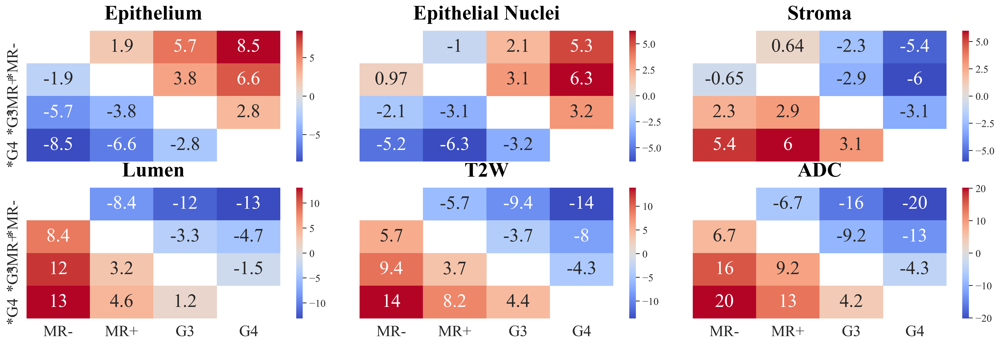

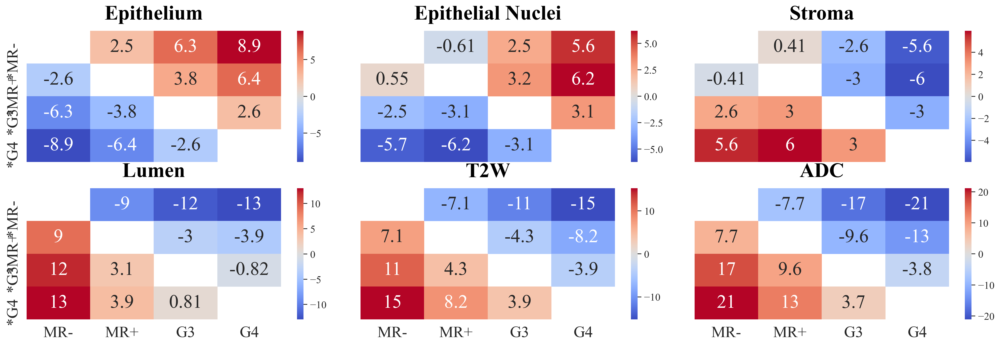

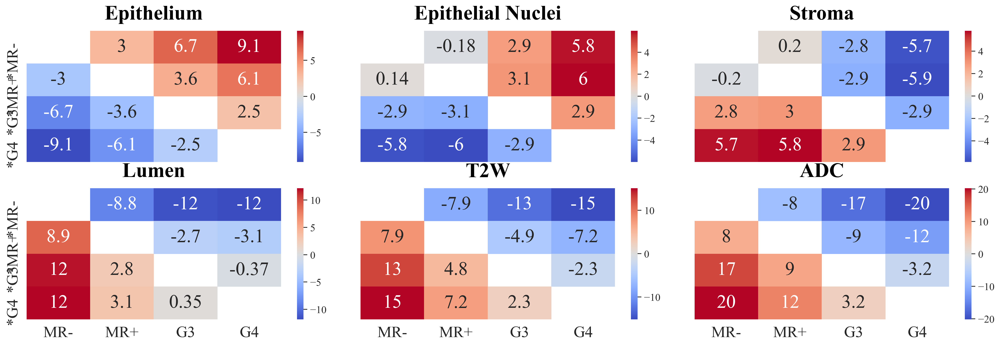

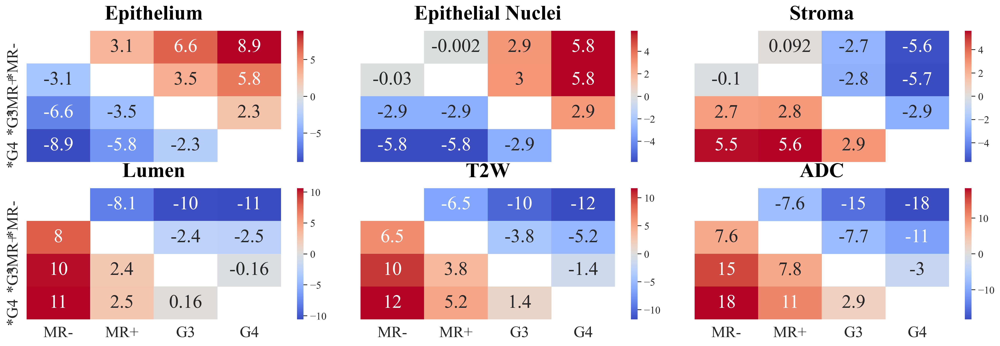

In [33]:
def draw_heatmap(*args, **kwargs):
    data = kwargs.pop('data')
    d = data[args[2]]
    d = d.replace({0: np.nan})
    sns.heatmap(d, **kwargs)

for diameter in [7, 5, 3, 1]:
    mnlogit_d = mnlogit[mnlogit.Diameter == f'{diameter}mm'].drop('Diameter', axis=1)
    g = sns.FacetGrid(mnlogit_d, col='Tissue', col_wrap=3, dropna=True, aspect=2, height=3)
    g.set_axis_labels("Control Group", "Group")
    g.map_dataframe(draw_heatmap, 
                    "", "", mnlogit_d.columns[-4:], annot=True, annot_kws={"fontsize":24}, cmap='coolwarm')
    g.fig.subplots_adjust(wspace=.05, hspace=.2)
    decorate(g, mnlogit['Tissue'].unique(), skip_legend=True)
    save_fig(f'mnlogit_4class_{diameter}mm')

In [34]:
f_melt = melt_df(f, d)
sub_g_merged_G_1 = f_melt.copy()
sub_g_merged_G_1 = replace(sub_g_merged_G_1, '3+3/3+4', 'GleasonGrade')
sub_g_merged_G_1 = replace(sub_g_merged_G_1, '4+3/4+4/4+5/5+5', 'GleasonGrade')
sub_g_merged_G_1['GleasonGrade'].replace(dict(grades), inplace=True)
print(sub_g_merged_G_1.head())

   Condition GleasonGrade     ImgType  measure_7mm
0          1           G3  Epithelium     0.513104
1          1           G4  Epithelium    -0.175708
2          1           G3  Epithelium     0.206987
3          0          MR+  Epithelium    -2.029331
4          0          MR+  Epithelium     0.214861


In [35]:
sub_g_merged_G_1

,Condition,GleasonGrade,ImgType,measure_7mm
0,1,G3,Epithelium,0.513104
1,1,G4,Epithelium,-0.175708
2,1,G3,Epithelium,0.206987
3,0,MR+,Epithelium,-2.029331
4,0,MR+,Epithelium,0.214861
...,...,...,...,...
6085,-1,MR-,ADC,1.032147
6086,-1,MR-,ADC,0.339762
6087,-1,MR-,ADC,1.299031
6088,-1,MR-,ADC,0.293581


<AxesSubplot:ylabel='Normalized Measure'>

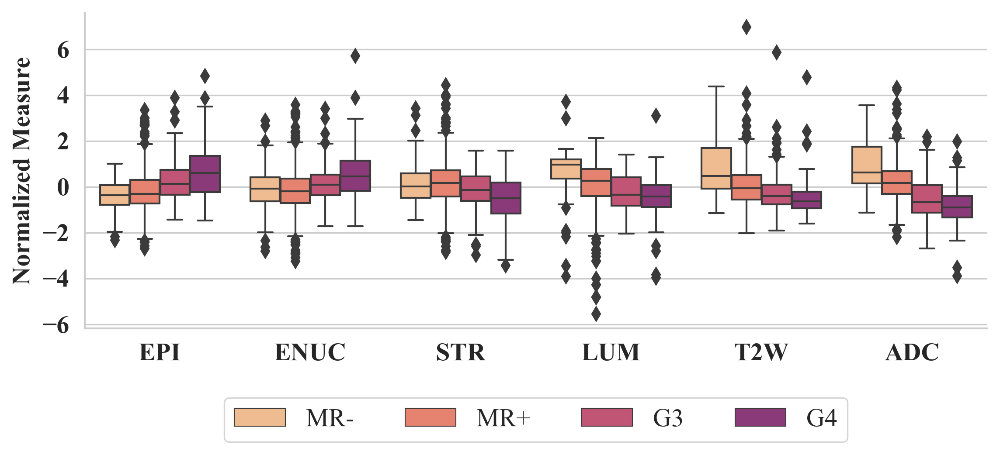

In [36]:
col_name = f_melt.columns[-1]
palette = sns.color_palette('magma', )
# palette = sns.cubehelix_palette()
palette.reverse()
sns.set_context("paper", font_scale=1.2, rc={"lines.linewidth": 1})
boxplot = sns.catplot(x="ImgType", y=col_name, hue="GleasonGrade",
                      hue_order=[g[1] for g in grades],  # [-1, 0, '3+3/3+4', '4+3/4+4/4+5/5+5']
                      data=sub_g_merged_G_1,
                      kind="box", height=3, aspect=2.5, legend=False, 
                      palette=palette
                      )
boxplot.ax.legend(loc='lower center', bbox_to_anchor=(.5, -.4), ncol=4, fontsize=14)
boxplot.ax.set(xticklabels=reduced_ticks, xlabel=None)
boxplot.ax.set_ylabel(ylabel='Normalized Measure', fontdict={'fontsize': 14, 'weight': 'bold'})
set_ticks(boxplot.axes, '', 14, 'bold')
# Note: Have to manually save this image, as the ylabel and legend are out of frame when using save_fig

In [37]:
dir_in = r'C:\Users\Minh\Google Drive\Writing\RadPath\Analysis\model_logs'
from glob import glob
df = []
files = glob(dir_in + '/*.csv')
for file in files:
    df.append(pd.read_csv(file))
    model = 'Semi-supervised Learning' if '_TSA' in file else 'Supervised Learning'
    metric = 'MAE' if 'l1' in file else 'SSIM'
    tissue_type = file[-7:-4]
    tissue_type = 'ENUC' if tissue_type == 'NUC' else tissue_type
    df[-1]['model'] = model
    df[-1]['tissue_type'] = tissue_type
    df[-1]['metric'] = metric
#     df[-1].Value = savitzky_golay(df[-1].Value.values, 11, 1)
df = pd.concat(df, axis=0, ignore_index=True)
df[(df.tissue_type == 'EPI') & (df.model == 'Supervised Learning') & (df.metric == 'MAE')].Value

0      0.299182
1      0.285224
2      0.263629
3      0.201212
4      0.090720
         ...   
195    0.080174
196    0.080411
197    0.079857
198    0.080174
199    0.080316
Name: Value, Length: 200, dtype: float64

In [38]:
steps = np.linspace(99, 1999, 20).reshape((-1, 20))
steps = np.tile(steps.T, (1, 10)).astype('int64').reshape(-1)
steps = np.tile(steps, len(df[df.Step == 9]))
df = df.assign(Steps=steps.reshape(-1))
col_order = ['EPI', 'ENUC', 'STR', 'LUM']

In [39]:
ylims = []
for i in range(8):
    ylabel = 'MAE' if i < 4 else 'SSIM'
    _df = df[(df.tissue_type == col_order[i % 4]) & (df.metric == ylabel)]
    y = _df.Value
    if ylabel == 'MAE':
        ylim = [y.min() * 0.95, y.min() * 1.3]
    else:
        ylim = [y.max() * 0.9, y.max() * 1.01]
    ylims.append([round(_ylim, 3) for _ylim in ylim])
print(ylims)

[[0.064, 0.087], [0.055, 0.075], [0.091, 0.125], [0.064, 0.087], [0.748, 0.84], [0.761, 0.854], [0.748, 0.84], [0.721, 0.809]]


No handles with labels found to put in legend.


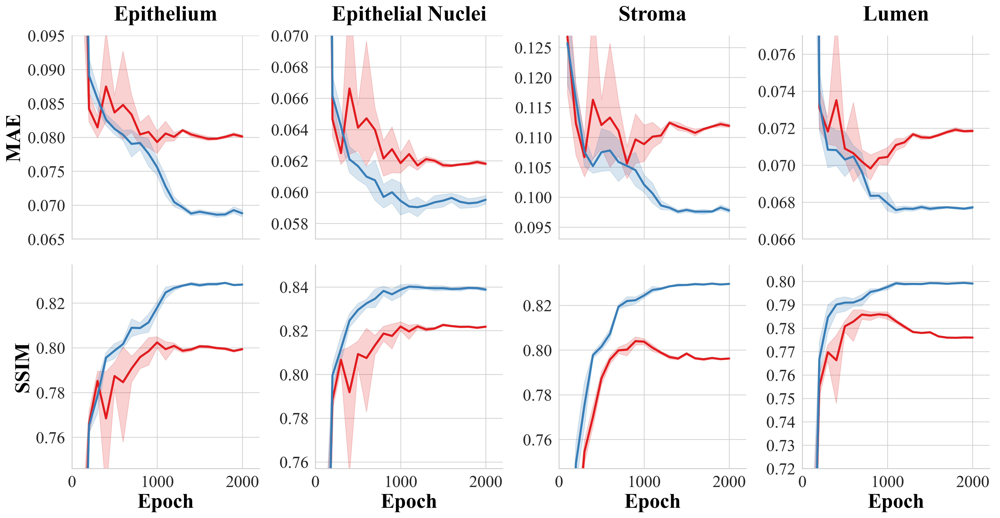

In [40]:
rp = sns.relplot(x='Steps', y='Value', hue='model', col='tissue_type', row='metric', data=df, kind='line', linewidth=2.5,
                 facet_kws={'sharey': False, 'sharex': True}, col_order=col_order, legend=None, height=4, aspect=1,
                palette=sns.color_palette('Set1', 2), )
decorate(rp, list(mnlogit['Tissue'].unique()[:4]) * 2, skip_legend=False)

#0.089
y_lim = [[0.065, 0.095], [0.057, 0.07], [0.093, 0.127], [0.066, 0.077], 
         [0.746, 0.837], [0.757, 0.85], [0.747, 0.838], [0.72, 0.807]]

for i, ax in enumerate(rp.axes.flatten()):
    ylabel = 'MAE' if i < 4 else 'SSIM'
    y = df[(df.tissue_type == col_order[i % 4]) & (df.metric == ylabel)].Value
    ax.set_ylabel(ylabel) if i % 4 == 0 else ax.set_ylabel('')
    if i > 3:
        ax.set_title('')
    ax.set_ylim(y_lim[i])
    ax.set_xlabel('Epoch')
ax.set_xlim([0, 2200])
ax.set_xticks(np.linspace(0, 2000, 3))
plt.subplots_adjust(wspace=.3)

save_fig('validation_curves', bbox_inches='tight')

In [41]:
df[(df['Step'] == 1999) & (df['metric'] == 'SSIM')]

,Wall time,Step,Value,model,tissue_type,metric,Steps
999,1.605177e+09,1999,0.800107,Supervised Learning,EPI,SSIM,1999
1199,1.605177e+09,1999,0.776121,Supervised Learning,LUM,SSIM,1999
1399,1.605177e+09,1999,0.822756,Supervised Learning,ENUC,SSIM,1999
1599,1.605177e+09,1999,0.797165,Supervised Learning,STR,SSIM,1999
2599,1.602105e+09,1999,0.828375,Semi-supervised Learning,EPI,SSIM,1999
2799,1.602105e+09,1999,0.798344,Semi-supervised Learning,LUM,SSIM,1999
2999,1.602105e+09,1999,0.838177,Semi-supervised Learning,ENUC,SSIM,1999
3199,1.602105e+09,1999,0.828830,Semi-supervised Learning,STR,SSIM,1999


   Condition GleasonGrade     ImgType  measure_5mm
0          1           G3  Epithelium     0.542902
1          1           G4  Epithelium    -0.215506
2          1           G3  Epithelium     0.190093
3          0          MR+  Epithelium    -2.024363
4          0          MR+  Epithelium     0.268038


<AxesSubplot:ylabel='Normalized Measure'>

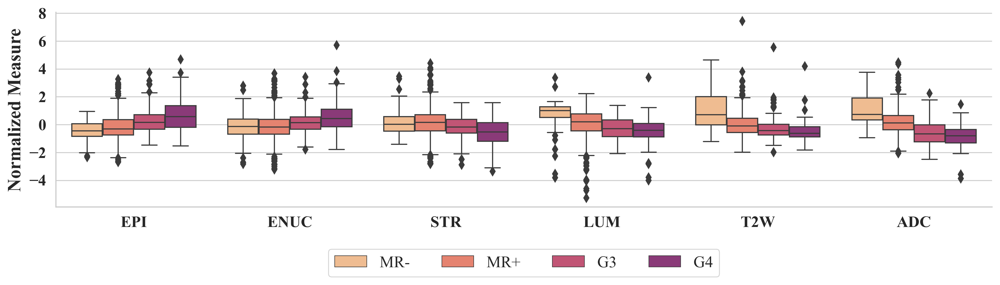

In [42]:
d = 5
f = read_pdf(d)
f_melt = melt_df(f, d)
f_melt = melt_df(f, d)
sub_g_merged_G_1 = f_melt.copy()
sub_g_merged_G_1 = replace(sub_g_merged_G_1, '3+3/3+4', 'GleasonGrade')
sub_g_merged_G_1 = replace(sub_g_merged_G_1, '4+3/4+4/4+5/5+5', 'GleasonGrade')
sub_g_merged_G_1['GleasonGrade'].replace(dict(grades), inplace=True)
print(sub_g_merged_G_1.head())

col_name = f_melt.columns[-1]
palette = sns.color_palette('magma', )
# palette = sns.cubehelix_palette()
palette.reverse()
sns.set_context("paper", font_scale=1.2, rc={"lines.linewidth": 1})
boxplot = sns.catplot(x="ImgType", y=col_name, hue="GleasonGrade",
                      hue_order=[g[1] for g in grades],  # [-1, 0, '3+3/3+4', '4+3/4+4/4+5/5+5']
                      data=sub_g_merged_G_1,
                      kind="box", height=3, aspect=4, legend=False, 
                      palette=palette
                      )
boxplot.ax.legend(loc='lower center', bbox_to_anchor=(.5, -.4), ncol=4, fontsize=14)
boxplot.ax.set(xticklabels=reduced_ticks, xlabel=None)
boxplot.ax.set_ylabel(ylabel='Normalized Measure', fontdict={'fontsize': 16, 'weight': 'bold'})
set_ticks(boxplot.axes, '', 14, 'bold')
# Note: Have to manually save this image, as the ylabel and legend are out of frame when using save_fig

In [43]:
from scipy.stats import combine_pvalues
combine_pvalues([ 0.0412, 0.0523, 0.0911, 0.1011, 0.1267 and 0.4500])

(23.252052508855247, 0.009853488000461475)